In [1]:
import numpy as np 
import pandas as pd 
import pandas_profiling as pp
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import os

# 1.Reading the data

In [2]:
higg=pd.read_csv("C:\\Users\\Debashish\\Downloads\\Higgs.csv")

# 2. Understanding,Summary Statistics Data

In [42]:
#pp.ProfileReport(higg)

#### Dropping the "id" column as it will put impact on the result.

In [4]:
higg.drop(columns=['id'], axis = 1, inplace = True)

#### Checking the data type of the columns

In [41]:
higg.dtypes

class                       category
lepton_pT                    float64
lepton_eta                   float64
lepton_phi                   float64
missing_energy_magnitude     float64
missing_energy_phi           float64
jet1pt                       float64
jet1eta                      float64
jet1phi                      float64
jet1b.tag                   category
jet2pt                       float64
jet2eta                      float64
jet2phi                      float64
jet2b.tag                   category
jet3pt                       float64
jet3eta                      float64
jet3phi                      float64
jet3b.tag                   category
jet4pt                       float64
jet4eta                      float64
jet4phi                      float64
jet4b.tag                   category
m_jj                         float64
m_jjj                        float64
m_lv                         float64
m_jlv                        float64
m_bb                         float64
m

# 3. Data pre-processing

#### The following columns are having 5 levels. So, converting the columns into "Categorical" type

In [6]:
for col in ["jet1b.tag","jet2b.tag","jet3b.tag","jet4b.tag","class"]:
        higg[col] = higg[col].astype('category')
cat_attr = list(higg.select_dtypes(include=['category']).columns)
cat_attr.pop(0)

'class'

#### The following object contains all the numerical variables

In [8]:
num_attr = list(higg.columns.difference(cat_attr))
num_attr.pop(0)

'class'

# 4.Train and Test split of data

#### Separating the independent and dependent variables

In [10]:
from sklearn.model_selection import train_test_split
X, y = higg.loc[:,higg.columns!='class'], higg.loc[:,'class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

#### Train/Test split

In [11]:
## Print the shape of X_train, X_test, y_train, y_test
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)
print(y_train.unique())

(54908, 28)
(13728, 28)
(54908,)
(13728,)
[0, 1]
Categories (2, int64): [0, 1]


#### a)Splitting the categorical and numerical data
#### b)Saving the data in the respective objects and making them into a dataframe.

In [12]:
X_train_cat=(X_train[cat_attr])
X_train_cat=pd.DataFrame(X_train_cat,columns=cat_attr)

In [13]:
X_test_cat=(X_test[cat_attr])
X_test_cat=pd.DataFrame(X_test_cat,columns=cat_attr)

In [14]:
X_train_num=(X_train[num_attr])
X_train_num=pd.DataFrame(X_train_num,columns=num_attr)

In [15]:
X_test_num=(X_test[num_attr])
X_test_num=pd.DataFrame(X_test_num,columns=num_attr)
X_test_num=X_test_num.reset_index()

In [16]:
print(X_train_cat)
print(X_test_cat)
print(X_train_num)
print(X_test_num)

      jet1b.tag jet2b.tag jet3b.tag jet4b.tag
3249   2.173076  0.000000  0.000000  3.101961
46306  2.173076  0.000000  2.548224  0.000000
58127  2.173076  0.000000  2.548224  0.000000
17142  2.173076  0.000000  1.274112  0.000000
30011  2.173076  0.000000  2.548224  0.000000
...         ...       ...       ...       ...
63206  2.173076  0.000000  0.000000  3.101961
61404  2.173076  0.000000  2.548224  0.000000
17730  2.173076  0.000000  0.000000  3.101961
28030  2.173076  2.214872  0.000000  0.000000
15725  1.086538  0.000000  0.000000  0.000000

[54908 rows x 4 columns]
      jet1b.tag jet2b.tag jet3b.tag jet4b.tag
43962  2.173076  1.107436  0.000000  0.000000
66558  0.000000  1.107436  0.000000  0.000000
3215   2.173076  0.000000  0.000000  3.101961
27367  0.000000  2.214872  0.000000  3.101961
1494   2.173076  0.000000  2.548224  0.000000
...         ...       ...       ...       ...
32966  0.000000  1.107436  0.000000  0.000000
38210  2.173076  0.000000  2.548224  0.000000
25502  0

#### Encoding Categorical Attributes to Numeric - OneHotEncoding

In [17]:
from sklearn.preprocessing import OneHotEncoder
onehotencoder = OneHotEncoder(handle_unknown='ignore')
onehotencoder = onehotencoder.fit(X_train_cat)
ohe_cat_col_names = onehotencoder.get_feature_names(cat_attr)
ohe_cat_col_names

array(['jet1b.tag_0.0', 'jet1b.tag_1.086538',
       'jet1b.tag_1.0865380759999999', 'jet1b.tag_2.173076',
       'jet1b.tag_2.1730761530000002', 'jet2b.tag_0.0',
       'jet2b.tag_1.107436', 'jet2b.tag_1.107436061',
       'jet2b.tag_2.214872', 'jet2b.tag_2.214872122', 'jet3b.tag_0.0',
       'jet3b.tag_1.2741120000000001', 'jet3b.tag_1.274112225',
       'jet3b.tag_2.5482240000000003', 'jet3b.tag_2.548224449',
       'jet4b.tag_0.0', 'jet4b.tag_1.5509806869999998',
       'jet4b.tag_1.550981', 'jet4b.tag_3.101961',
       'jet4b.tag_3.1019613739999996'], dtype=object)

In [18]:
X_train_cat_onehotencoded = onehotencoder.transform(X_train_cat).toarray()
X_train_cat_onehotencoded = pd.DataFrame(X_train_cat_onehotencoded, columns=ohe_cat_col_names)
X_train_cat_onehotencoded.head()

,jet1b.tag_0.0,jet1b.tag_1.086538,jet1b.tag_1.0865380759999999,jet1b.tag_2.173076,jet1b.tag_2.1730761530000002,jet2b.tag_0.0,jet2b.tag_1.107436,jet2b.tag_1.107436061,jet2b.tag_2.214872,jet2b.tag_2.214872122,jet3b.tag_0.0,jet3b.tag_1.2741120000000001,jet3b.tag_1.274112225,jet3b.tag_2.5482240000000003,jet3b.tag_2.548224449,jet4b.tag_0.0,jet4b.tag_1.5509806869999998,jet4b.tag_1.550981,jet4b.tag_3.101961,jet4b.tag_3.1019613739999996
0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [19]:
X_test_cat_onehotencoded = onehotencoder.transform(X_test_cat).toarray()
X_test_cat_onehotencoded = pd.DataFrame(X_test_cat_onehotencoded, columns=ohe_cat_col_names)
X_test_cat_onehotencoded.head()

,jet1b.tag_0.0,jet1b.tag_1.086538,jet1b.tag_1.0865380759999999,jet1b.tag_2.173076,jet1b.tag_2.1730761530000002,jet2b.tag_0.0,jet2b.tag_1.107436,jet2b.tag_1.107436061,jet2b.tag_2.214872,jet2b.tag_2.214872122,jet3b.tag_0.0,jet3b.tag_1.2741120000000001,jet3b.tag_1.274112225,jet3b.tag_2.5482240000000003,jet3b.tag_2.548224449,jet4b.tag_0.0,jet4b.tag_1.5509806869999998,jet4b.tag_1.550981,jet4b.tag_3.101961,jet4b.tag_3.1019613739999996
0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0


#### Merging the categorical and numerical columns into train and test data

In [20]:
X_train = pd.concat([X_train_num.reset_index(), X_train_cat_onehotencoded], axis=1)
X_train.shape

(54908, 45)

In [21]:
X_test = pd.concat([X_test_num, X_test_cat_onehotencoded], axis=1)
X_test.head()

,index,jet1eta,jet1phi,jet1pt,jet2eta,jet2phi,jet2pt,jet3eta,jet3phi,jet3pt,...,jet3b.tag_0.0,jet3b.tag_1.2741120000000001,jet3b.tag_1.274112225,jet3b.tag_2.5482240000000003,jet3b.tag_2.548224449,jet4b.tag_0.0,jet4b.tag_1.5509806869999998,jet4b.tag_1.550981,jet4b.tag_3.101961,jet4b.tag_3.1019613739999996
0,43962,0.456471,0.140418,0.444387,-1.008226,1.314846,1.131747,-0.204633,-1.484672,0.530728,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,66558,-1.732928,1.465375,3.581476,0.069028,-0.409113,2.186692,1.409238,-0.715254,1.300476,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,3215,-0.056469,-0.898033,0.851306,1.445464,0.024312,1.349308,2.381383,-1.717106,1.477854,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,27367,1.034765,-1.179655,0.639235,0.804358,-0.293153,0.816358,-0.357555,-0.335812,0.808912,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,1494,-0.351557,-0.687924,0.951891,-0.350606,-0.022951,0.770655,-0.994729,1.204236,1.715820,...,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0


In [22]:
print(X_train.shape)
print(X_test.shape)
print(len(y_train))
print(len(y_test))

(54908, 45)
(13728, 45)
54908
13728


In [23]:
y_train,y_test=y_train,y_test.astype('category')

In [24]:
y_train.unique()

[0, 1]
Categories (2, int64): [0, 1]

#### Define custom function to print accuracy, precision and recall

In [38]:
# Define custom function to print accuracy, precision and recall
from sklearn.metrics import accuracy_score

def convert_for_sklearn(label_list):
    return [1 if i == 'Yes' else 0 for i in label_list]


def accuracy(y_true, y_pred, data_mode):
    
    y_test_scoring = convert_for_sklearn(y_true)
    test_pred_scoring = convert_for_sklearn(y_pred)
    
#     y_test_scoring = y_true
#     test_pred_scoring = y_pred
    
    acc = accuracy_score(y_true= y_test_scoring, y_pred = test_pred_scoring)
    
    print(f"{data_mode} Accuracy: ",acc)

#### Applying the Random Forest-Decision Tree Algorithm to aolve this classification problem

In [26]:
from sklearn.ensemble import RandomForestClassifier

clf_rf = RandomForestClassifier()

#### Finding the best parameters to build a model through GridSearchCV

In [27]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV

kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=143)

param_grid = {"n_estimators" : [30,36],
              "max_depth" : [5,8],
              "max_features" : [8,10],
              "min_samples_leaf" : [4, 6]}

rf_grid = GridSearchCV(clf_rf, param_grid= param_grid, cv=kfold)

#### Fitting the model into Train data

In [28]:
rf_grid.fit(X_train,y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=143, shuffle=True),
             error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                           

#### Finding the best parameters and the features which would give better prediction for the model.

In [29]:
rf_grid.best_params_

{'max_depth': 8, 'max_features': 10, 'min_samples_leaf': 6, 'n_estimators': 36}

In [30]:
rf_grid.best_estimator_.feature_importances_

array([3.68913543e-03, 6.23479696e-03, 4.43638229e-03, 7.36687667e-02,
       4.38778603e-03, 3.64412305e-03, 3.65534274e-02, 4.93012623e-03,
       3.87860656e-03, 1.03825426e-02, 4.37638094e-03, 4.32068826e-03,
       1.15173163e-02, 4.79150832e-03, 3.32217728e-02, 4.32659575e-03,
       3.05324026e-01, 2.01176417e-02, 8.09703086e-02, 6.60758607e-02,
       7.67116227e-03, 1.34188093e-01, 1.12217796e-01, 3.53185887e-02,
       4.37131223e-03, 7.17334301e-03, 6.49340513e-04, 1.14988044e-04,
       3.19924338e-03, 1.08611113e-04, 2.69129877e-03, 4.88514555e-04,
       0.00000000e+00, 7.22872455e-04, 2.61194425e-04, 1.29333742e-03,
       3.95970021e-04, 1.07194457e-04, 4.36447902e-04, 1.07330557e-04,
       7.44833591e-04, 6.98515625e-05, 1.34556714e-04, 5.92127343e-04,
       9.41989677e-05])

#### Sorting the features according to their score

In [31]:
features = X_train.columns
importances = rf_grid.best_estimator_.feature_importances_
indices = np.argsort(importances)[::-1] # np.argsort returns the indices that would sort an array.
pd.DataFrame([X_train.columns[indices],np.sort(importances)[::-1]])

,0,1,2,3,4,5,6,7,8,9,...,35,36,37,38,39,40,41,42,43,44
0,m_bb,m_wbb,m_wwbb,m_jjj,jet1pt,m_jlv,jet2pt,missing_energy_magnitude,lepton_pT,m_jj,...,jet3b.tag_1.2741120000000001,jet2b.tag_2.214872122,jet4b.tag_1.550981,jet1b.tag_1.0865380759999999,jet1b.tag_2.1730761530000002,jet3b.tag_2.548224449,jet3b.tag_1.274112225,jet4b.tag_3.1019613739999996,jet4b.tag_1.5509806869999998,jet2b.tag_1.107436061
1,0.305324,0.134188,0.112218,0.0809703,0.0736688,0.0660759,0.0365534,0.0353186,0.0332218,0.0201176,...,0.00039597,0.000261194,0.000134557,0.000114988,0.000108611,0.000107331,0.000107194,9.4199e-05,6.98516e-05,0


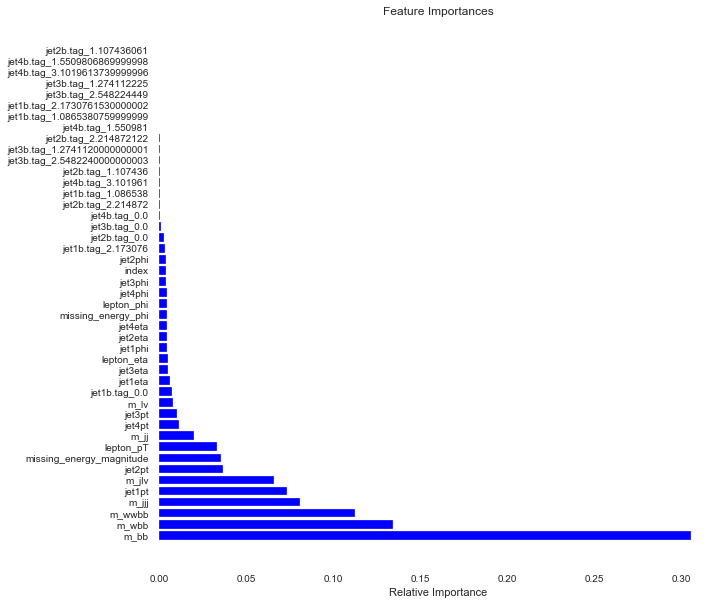

In [32]:
plt.figure(figsize = (10, 10))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='blue')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

#### Predicting the train and test data

In [33]:
train_pred = rf_grid.predict(X_train)
test_pred = rf_grid.predict(X_test)

#### Accuracy Score for Train and Test Data

In [39]:
# Using the function to calculate accuracy, precision and recall.
accuracy(y_true = y_train, y_pred = train_pred, data_mode='Train')

Train Accuracy:  1.0


In [40]:
accuracy(y_true = y_test, y_pred = test_pred, data_mode='Test')

Test Accuracy:  1.0
